---
---
# Video Object Detection using YOLO - German Tourism Monitoring
---
---

## Lab Overview

This lab provides a hands-on approach to understanding and implementing state-of-the-art object detection techniques for monitoring tourist activities at important German landmarks. You will learn to detect and track people, vehicles, and objects in video footage from popular tourist destinations such as Brandenburg Gate, Neuschwanstein Castle, and Cologne Cathedral.

### Learning Objectives:
- Implement YOLO for real-time object detection in tourism surveillance
- Process video footage from German tourist attractions
- Analyze crowd density and tourist behavior patterns
- Create automated monitoring systems for heritage site protection

## Setup and Installation

First, let's install the required packages for our German tourism monitoring system.

In [4]:
!pip install ultralytics opencv-python

In [8]:
import cv2
import urllib.request
import torch
import matplotlib.pyplot as plt
import requests
import urllib.request
import numpy as np
%matplotlib inline

## Load Data

In this section, we'll download sample images and videos from German tourist attractions for our object detection exercises.

### Download Sample Images

Let's start by downloading sample images from German landmarks for initial testing.

In [1]:
# TODO: Download sample images of German tourist attractions
# Create a directory for sample data
# Download images from URLs or use sample tourism images
# Suggested locations: Brandenburg Gate, Neuschwanstein Castle, Cologne Cathedral

import os
import urllib.request

# Create directories
os.makedirs('german_tourism_data/images', exist_ok=True)
os.makedirs('german_tourism_data/videos', exist_ok=True)
os.makedirs('german_tourism_data/results', exist_ok=True)

# TODO: Add code to download sample images
# Example German tourist attractions (replace with actual URLs)
#sample_images = {
 #   'brandenburg_gate.jpg': 'https://images.pexels.com/photos/7102728/pexels-photo-7102728.jpeg?auto=compress&cs=tinysrgb&w=1260&h=750&dpr=1',
  #  'neuschwanstein.jpg': 'https://images.pexels.com/photos/187854/pexels-photo-187854.jpeg?auto=compress&cs=tinysrgb&w=1260&h=750&dpr=1',
   # 'cologne_cathedral.jpg': 'https://images.pexels.com/photos/10605263/pexels-photo-10605263.jpeg?auto=compress&cs=tinysrgb&w=1260&h=750&dpr=1'
#}

# YOUR CODE HERE
# Download each image and save to the images directory

# files were uploaded manually to german_torusm_data file

Sample Images

In [ ]:
# Download the image from the URL

url = 'PBrLwRJw/J7o9F7gGyIyU9GuLYGVptLTAVnpCrG8c89ub6+ch91pSak0rrZksurIcOw6jpPOObBd9FmonMRlB3k9slS9J4inyW883m/q5D7lh57YrLLYvkNVMNzTXOq1IAMS8NA+joWmB6wF10tG6dxPDxpt3Umr6zbss7vN5ZeRz8dojDSpOcI2cU7aqSu927MjsxtA2FamSeDwV7V6Qwy21I96PJej8V7OXcx9r2bnBQ9KYT2sfeRL0bi/ZS91iw5v1gl6UwftY+8g9HYv2UvdYDVYPpjxR6Twj/yx95B6Oxfspe6xIxNL+Iz+YJ+kcL7WPvIPR+K9lL3X8g+k0v4jP5gj0jhfax95fMPR+K9lL3X8jxxlEa1WfzBL0hhfaR70P0fivZS91iTtCiNarP5gj0hhn/kj3ofo/Feyl3MlALXcyWDlRcAwlcLBhFx2DlRcdj2VK4jEQtREUAmB5wSA8wmbhFx2Q8SN6ZEsNk1BnDfouMH4rh/aDBwrYR1XlKGafl1P63o7Og8TOniVS2qXknmbamxkAEyI0AtYXNrjivm2+92e5ccrC3BkRmGUjSLabjqL31RnrXuLVyt8Sg2pjqbCQMpncBvIAsdRe+uqnGlKUrjdoxsU79pVnksZSPSveWt0vBdEaTqtSoR5TfmUuqlkRRhMY6Q4Bs3vVEcLRUMcVZakndeH8FfCNoTS2JWJdzlSCeDg4aRYZrJuUctVEdbpFjk2IdNSSd8G3YM8DwRwrvs+u4V0PbJ2SGYimMwN4sCJsdb+5Z8TNunLItpNayLraOEqsquy1YaYtIsctIAxqZudyqo6jgrr6zLJSd7oXzNbOWh7jfUOBc4w4EAaRF47LKLUWhqVs2Ko4Wq9jnS4TYiTLJDZH2dCnZRdg1hqm2sx0B2btMDiLSTA9gvvVmrGV3awtawgYKs6CS7pTMOsLWMz0b9qjJxjsQ9u0FWk9oLWl4no5i8yTcWJgTYbuuwIUVnmwukQ+WuBMYeS2CH8eDPircJLlW+tpXVknYq6XJ5j2mXNvv6Yi0Wh1tNy0OtJPYU6qA7k+RIFeD2EbgBeSf0U+GT2xJWy2iBgMXSb0ajHdQqOnQDVxAGniSpPgpPNNdwlOSPUtoYig2ajLGBIc1x9UDc4ncTPWk8PCo+K/gSjWttLnZm2WgXYJMCXC9g0b+sE9pKoq4drIthOLNJsxtKMwDJMawdw1neTJ71mmWapMbg6QkgMnjYmIvqeMnv6lFttWuRSzzKutQp5jDGTxDRPf+uHBdjQWEhiK/rHlHO3Pnv6PE5mmsTPD0OJtk7X5stw0WL6Bc8MeyouMOVFwseyouMOVK4BhFx2MMFtKhUJAFrUALAQI9TY872DtDzbu3rz2kNOVsHV4OVLqd8mu472C0PSxVNTjV61bY+baW+By023ZRe6TDiMQ0+Rhedx2nq+IUo2tBqzjk/ja/xOzhdDUqDUk+Mt/wDF7FoNtVG/Qp3t62I+K42vSf5X3nU1Ki/P8ADargQ0tpwftYgx5pt03sQKNVfn+BOdWLozUsK7rNIk9twnGcIqyT7yt0ZPbL4fyONrH+Fhf+i73hDqLmfeL7u/1fD+RXpT/qYYf8opcLF7n3j+7v8AUKGLf9TDf9Jw9yfCx5n3i+7v9Ql+Nff5vD/yP+Ci5w2595JYd85Gq13SHNZRzDS1SfGFTOUJLf3lkKUovb8B07Wr3PN0Tbi+/i1QjqrJXHwT5x3+mKmWeaonQQQ4e5SvHffvI8C/1fXeNVdrVSQeYw7v5rcL5E247tYapS/UedtWsR+6w990unrnocd6JKLW1gqUk9v13jZx1XfSw/bDj/4qDUOeRJQlz/XeLpbSqiYZQHZnHHq601qPnFwcucbxNd9SM4pOyzAzOETGnRPAKScI5oODludh0Y97bCjTP/Md/wCoqarQ2NMg6Etut9d4DtB/8GkP7bv/AF3UuFhzMToS/V8B2ninuE83R7Jd4+qpKpTa2EeAkvzfAUa7v4eHPef8iblDmfeHAvn+BHxjpALsNhXkaZjpOsTTMaeSfCxS394KjLcyO3EEf7ii3gGVHR5MAHgqpcG3nctUaiWUvgeftEtBHNU+6pU/yIXA8zGlV/V8BujjXGXc1SBO41KnuYFswuKeGk50cm8tzMmKwixEVCq7pO/1Yg4natVp9SnH33zH8mq7sPtC7JOF31/wciX2fV21P4bPiWWFL3Nl7Awk2aHZrbpMC/UvRUKkqkFKUdW+44FenGE3GMta28eyq65VYOVK4WDlRcdj2VFx2MGAtxnFAIAIQAtqBDgYDqAeE/ksGktHQxtLVbtJbHzdfQ95u0fj5YOpfbF7V5rpX8dSKdaXEFjWkQOjpeSNV88r4WrQqSpT2o91RrwrQVSGxk12Jzw3mWgO+mARB4idf9Vn4Fq7uW647gHsglzA7QidbzYRE6Jak3sY20SnVwHtgATlgWy3te0wlaWxjyJbcc05gWBuU2gSSIDrTbem6c1ZiTTI1faTKbSXUw8ZhfQgFoO6N5hRVJtjcrIQ7Fw+JJE6GIjKXROuijabJZDXpIfm1ZlMHibA6HtT4OatmJTQ6zaDGw0snUZt1tJPGI8VF0p3dmPWQh+NDTpm1tAExA171NQm94nJBp49rxOXLBuBffCHCcd9wTTB6Q2Q3XiYMTYxM9fBPUmle4tZMR6XEQ2QdfPfPV5hJwk947oVnBfE2J4CNJ17lHUl2j1kP+kBwuzJc3F5aATr4eKk6Ur2uR1h1mIYwAZM5cRpYgEE33DRR4KY9ZCX1hlLiScpjKAI9YN14CQe5Pg5veLWQ1iKxsCI1m2+RAgzx8lHVlzkk09w/RcJINIQIGYjUkAzbQXhHBu17i1s7DGErtHSyzawDQJJBP0ROgKThJMesmgYrFBxb0MlhaATJmZ10gaHipJS5xXQ8K7cpimIbvJ8XQOq40mU9SS3kboZdiA25ZmvHZaZgd6Fry3jdkR8TXBNmAawI4CTrvUkpLeLImbL2O2oOcqUWtFi2HE5t8kbhpv/AD7+i9GTm1Vqt22pc/8AHj48LSek4wvSpbdjfN/PgXRavW3PL2PZUXHYOVK4WPZUXHYOVFwscwo4gjW633FKmnsJtKoDommZ3FraOgJkQhqAHGGEXttFa+wrWVRzjzmN3C9ogARHiV4DS7/Fzad9ngj3ujI2wsE1bLzZZYAsJDASYEjpGx7FyqjkszoxSLJtFg3Om28jSYVXCS3Meqt54UWWs4RBFydDOqSqO49VEZtdmYgOjSxOg4QrHrWIqw2ebcRLpm0AxIgAjyS4+0fFJbqLMwmR3kHTKL9ijFu42gVqbAbTcRqTIv8AE+KctZbxKzI9dlMRcgni7f39vmpwvJidkRqr2QZeLTpxME7+pT1WtgrreHDkZZaTeJ33tfyVbcm8ySSsSaj2gAZjpI6Q1F9I61J3FkMsq6dInwHH4pS1gVh+lSbYhx4+Ue9K0gyGa1cCYfF7zGhBG6OJTWtYLIXQxDSRmeDusQLQhqQsiyp0mfWJkk6jiHe0JO4WFmjTMXPH1hxngl1h1HqrWtcDmIMzq3dA4dQHckr7B2W0jkNa0Q71coEGNLC/YSlU2AtpIweHpuAJBtHX7utU68uYnqrcSDhGXGZ1wRq3Qg8Ap60ri1UefhGhpdmI3yCN4IO5N3SyFk3mVuLpNF83eTe9vcpxu2Jo0uyB8wwTPRHDTdovbaPf4an1I8TpCP4mfWPFq3XMlj2VO47BypXCx7Ki47ByouFjmXNLpGW7C2mgTY41kaSgQ6HHgmKw8xG0WazQipjGUnBvNsiASYG86GxXz/TOBjRxTjTbSaTtzXvs6Mj3eicXKvhlKazWV+e28bdta/zbA1wm7TAiCe+/YuNOj+pnVjLmOg4XZ1Wm8CoC9hm4OUwBJuCLwDr+awU6ak8kKdbLJ5ltQoYN4Bbm/nd8VJrDvc+8q1sQubuM1yywOGo5alOmCXkg5hmmAIIJns8Fop2llBtWHTlJ317GFq4wB5y02tIuC2xmAZtbfwWmVNqObJxkm8kdG2dsqnTJbiA8i2VwcRrJA14B3gubHVfGksugc5yeVNlqzZWD3Z/53fFSvRfOVa1dcxUcrNn4RmHNQMLywiGv6Qhzg075GoPcraUoXUabd2OLqN8e1jn9bGUQ9oFFonhP63b1udOeq3rMFJXtY2+wcFhywivnDg4gZTAIgOHbZ0dywNxXK37CcnP8tiz/AKNw8dAv7yq3JPYOOvvGRsXD6uLx2H8k1LnG9bcDF7PwjabsjqxeAS0AzJAmI1Urxlkr3ZBOonxrWMNji1lQiowF30id5AHAjz4LVSu1k8hytvRe8isBhq9RznMDMgHq6kmRqSbWKhVerlUk7PmISk0uIszbf0XheL/H8lQ5UudlfCVuZEHamHohhFLnC7t6wJMCdSB2kKN4vkX6S2DqX49jE7arcxULarczhlG62YBxHG08dytoRlLkstcla5J2DXo4iqym+mGh5IJkmAASd/2fNXTpuObkyt1MnZG4GysI1sBzgB1j4LK+Bbu2yuNSvsSRBxdNlhhw9/SykmIDtcthrAPZ2ocVa8E7dJZGcv8AJYyfKis+i/m60ubla4gQBcvEEbx0FOlHWzX1sJ6yaGKO26ZaOgCb8d3YYV3AS5xa6NVs3B02MzMaAaga5xG+0juEnxXtdH4WOHpJLa82+c8bj8TPEVXrbFdJc3/STlXQuYrBypXHY8GouFg5UrjseyouFjlwcV1TCDOeCAshxlYIDVHCdO33FRk9nWOKWfV8h9hUytoqdoVBzz5v6tu668bprjYt9S8D2WheLhI9b8WMbHpzVaOLgPMrhYhZHYps+hMzIbTfq4WHs77HwKy0oQcFGW8xPW1nKO45ZtvDvpYuoynWcwAiBmcAZaHWAtN47lGlQnV4kIa0uhXZueIhCGvUkorpdkV+16z8rBUql/rRLi6NOK008LWoSfCwcb7Lpq/eQWIo1l6qSlbbZp+BnaZzPd1g/hCurW1ESpco7Ny0a1+FeGmKlPI62ok2PvXM1YqMX9WKqDkpvmZi8PWqBo/aR31Pir3ozFvNUJe6/kWffsLezqx95fMj7Yr1DQdmq5m2tmneE6eCxFOalUpSiudxaXfYk8VQnxYTTfMmn5mNq1hzjNdR7Sug+QypcpGy2qKxxM0HODebp5o0zgFp/CufChKcMoN57k34FnCwhypJdbSFt9Mj947y+CX3Op7N+6/kP7zS/Wu9Hh6b/Ed5fBH3Sfs33P5B95p/rXeiDUZjC5vOPcWFzQ6wiC4AzYcVL7u4pt02utMfDQbspLvRE5YVCcU/KbOMjdY/krcLDi5kZyyR7kpXxEvFJxB6MwJtLurrRi6Dna0W+pPyCnUhHlNLrZpcTWxm6o/wHwWCOEqb6cu6XyLXXor8y70WXyfh5q1n4h5Jp5fWtEnSO0E94VipxU0mrc5TiJ60OI73KL5SaZ9KqdrPDKArMPlJ9o4f0kUuxDUFRuQw+TBFz3DxV9aLlBpK4RaTz2FvtqrjQz985pkCS1o7QCRrErHCioO9Sm7dKZbwkZZQkuyx0bkpgKeGw9MOd0n3k7yb2VlBRb1p79hhxE5TdlsRjPlPpftA62NHganxUaeUn1mih/TMPTgN10zbuJW+7FY6psoTh6J/qqf4QvYUX6uPUjxtaNqsl0vxHaM5ngnQiNLAtHvlTTzZFxyX1vH8qdwsHKi47ByIuFg5ErhY5E2poJv9V4yO7p6Lu0EaLBhvtC9leP8A6j5r+ew6OI0EttGXZL5/x2gq42mw5ajiwwT02uaDHBxEE9QN12aWksLVV4Tv2O/dtOXPRmKg+NG3avmRBt3DfxP7j/8AKr/vVLn+DKvuVbm+K+Yo8oMNb5zf9R/A/ZUZYmndZ/B8zJRwda0st3OuddJ7/wCU4UH1yexjz7kpY2jHa33MS0fXe74oiYnEiq81Kc5XCQSDewBt3LyOkKsauJnKOy68D1eAoulh4RltXzuTuTRJxFKf4jR/ej3rlYnkvqOhTO1bQcfS6IgwWs045nEz4eawu/q7fWa+ZTTtqy7fAx3KU/tuI++3/Cpr3X2bilhZO2eu/BHltNybqwW7UXjIzO3HiWTwd7ln+0L49Pqfijd9n48So+leDKnZ7RzoHYPYvOVuQeip8o6pyotTxrtDlpcdIpR71LRFpY6ins/6YMa2sJNrbZ+ZzplfNAce+6+knirE7acDCuh0jMwa6S4LlaZ/tX1rxOjof+7XU/Ay9RvSb1Ob7V5F8l9p67ejotJkSeJd+Jy9LoDLCdr8jyumnfE9i8x4Fdo5NhxrlEdh0gFpB4H8ljxsU6E78z8DThG1Xhb9S8TCcomg1z2N9i8NQyT6z3Ms7FjyGhtSsPst9pXoNDu85dSODppcSHWzXc5C9DY8/YczDmsQRbo0ySB9pxk8dF477RU1CrCSWbvfpzVj02hJylBxb2bOjIzvykPLcQ7iRT/CuPRinN9p2IP1SKHk5WIxVDrqNHi6PeuphFavHrMuMzoT6mdLxjGvaQ5ocIJuJgwRI4G69LWpRnTamro8vQnKnNODsw7Td0MGDqWAi8XgGeu4bZfP4X1o/W89hFK0+sqPlSb85TPER7VNK02PDcg5xS3zoNbda3DOqbJ2rhaeFoCriaLDzTbPqsabAA2J7F6bDz9XHqR5XEUpOrKy3skUNoYd1R5bXpFpZTIcKrCCZqAwZ6h4q1VFcg6crLIlDF0P49L/AKjPipcIhcHLmHW16MTz1KNJ5xkTwmVF1US4OXMNYra2GpC9Vrj9Wn0z35bN7SQs1bG0qXLdujf3bS+jg6tXkxM/V5bMBIbRbH2q4a7va1jgD2ErH6Wjui/gbVol2zkjluG2g6CDcaEH3g+xcydGN7o66m7CsRtAZQM0A/R3fym0dShGnK9wclaxIw+PpDUMiL9Cnr4JOFTp72F4k7DYujaRTk3/AHdPTvCqlCp097Jpx6O5De2cXhCxzXtpuYLmWAAmJGV9IZmm8cFKjGspcVtPr+eRCpqNZ2sVlKkGsAaegAcoJkwRa8aq9zvLPaCjZZFpyYk4ijP8Zn+K2VnxDWq+ryLKZ2/ZmNoYhzXNPzlMHomzgDYnLvEizhIsYOqz01mrmKalG65zn/KV/wC2V/v+xrQvb/Z3+1l+9+ETzeml6+P7F4yMpygY51Rkbm+0n4LLp2S4WCfN5nR0FF8DJ/7eSK7Y9NwrsneR7WrgYizgdynfWOxcpXU6uArvYbu5trj917RBG4/knoX+8p35/JnPx91QmuhnLPRzNivox4+47iWOFIyCOk3U9/uXK00/wj614nT0N/dLqZUV6ZDgeBv4ryN+Kz1m86fjGtGWPqNJ7fpecr0ugb/dO1nlNMf3PYvMjgrsnLFhIlYlYVkkDjZZcY/UT/a/Auwy9dD9y8TCcqcnpVQAiARF925eFwz4mZ7mZI5GvmtUv/u58HNHvXoNDP1surzOJpleqj1+TL7aGMc31Wk+PuK9NFJnm5Oxa8hXc96SKlwW0uqwLyvJfamylT6n4o72hW9STXP5GZ+UzENqVw9hzNcGwRoR0hI4jrXAwqtJ3PQJWppGd2VUyVaT4Jy1Kbo7HtJ8gunhv68F/svEz4r+hP8Aa/A3ztsOfIDCJB/V9V7OpQUYO73Hj6dW8llvNjgKVOphsM9/0GMeCYtDQZJ3cfylfMHu58z2Mm1KSW8xvylYptTmXU3Zm9MSNDBbod46WosrIcpmigmo5nOMM1x8biesrc7CQMFsrCOrPdWJeSZyOeWMaDvyt6bzbcIupyxmIhBKDsl2/wAIh93pyk28/gXJ2HghGWkACJEVaoA7tVUtJYr2j7kN4Si/yrvZCq7Nw0SKY7OcqSrlpHF+0fciLwdD9C+I3SweHa6ObadIzF7mz91wg96VTHYqcbOb+C8Bww1GLyivEl1MW09GC+3qiQ0D7jPfKyRg+ovbRW1triT0W9XQZpu3K5Yd22v4keENrs3Z9KvRaHOLXGkx5e5rHtLzmkFsTFtbm5034ak4RqPas+z4bPiWWk1fL6+ugy+z8C2tUGWfVJytEWtcCddB3rROo4Rz7yKim8hBxAFXm6NGrVdcQKmVwjWRkIEdqmovV1ptLs/ki5Z2R4RVrc1UFfDuDSR0w+b3kFjY7RKkm4Q1laX11sVrvmKblNg2ta/JVdU0nnGgOEetDhqIWnD1LyV1bqKqscnmXL6PzehmBut6p+Cyxd5F72D/ACX/APtUh/WA+Dgfco4hWgx03dmkZtItqU3G2UEAXBa4hx3XabdW9ZVFp5E3ZxzG9q1ZxFUm8v8A/Fq9x9nv7T/0/BHj9NL8Sv2rxkU+Obmf2NHtK5unpfiUv9V4s6mg1+Hf7n4IgbOH7TTEzLm93SC49X+m/rcdeHKNbs/Ek0a4Ljc05F91RgvNuN+tW6Jyx1NdfgzLpNL7rOXQMvpA7tV9AueIsQts0wKI++PwvK5Gm5fhu1HW0LH8T/5fkZ3Fjf390rykXkepZuy/ojtq/wCNVXqdB/2i62eV0uvxL6kBtRdc5lh5tRIdiVQrLNilehP9r8C6gvWw614nP8bQDqg6qdL/AAwvCwlZdrPb2H9kVeZquPGm4cL5qZ9y7ugVrV5L/V+KONpx2oJ/7LwkLxONqPNz3SV61JI8ve+0l7PxZZh8UJIBFPMJIDhFY5XEfRtfj2WXk/tKr1aXU/FHpdARXBzvufkRuUtcllA7yweTnj3LztBWbO/PYRsDZ1P/AIlPfum+5aqMvXR614oz14+pl1PwOo1KLYIgaH2L2E5PVZ5WEFdGV2htN/NUqeYlraNLKyYaJpMIMAXMzEnj3fOmm8j2sYRT1t5G5Q1pw1I6w+qPKlw7FOks0ujzB7X2eBlME7o2H6ut0ylFS6m70olv0qY1MCbgSR2HwV91wOfOVZ8JfoLmthX02Auq0CLWbck9XRuVSqkW7JMstKwupjcIXQC6T/Vjzhyr1atr+f8ABLWQ5iMAzKKjSCARN2QL6GHmP9FGNV31X9fAeqrXRbbGwLatOo8AFlOziakXiYbTYC4mCD39qhPWyzS6/wCX5DullZ9hT7Wo4fD1XUjQpvLY6TXuIMtDtT2x3LRTc5xUlIrkop7CmdyrxtN7adOtlaXmkAKdIwxjsjRLmE7zed6v+50JRcnHO19r2tXKHWqaySe+xrOSLIrk6RScfNnBcvF50+020+UZmjtSrSr03UnAOqVG0yS1rpa9wzCHAjcFuVKMoNTWSV+4onNxatvdi0wBnGVhqGzE3gSdOEqmVlQiyyK47Knbw6bhxd7WlaKHOVVDWYmgA0d3D7QWKnPM0SRW8n3xi6febdQJ9yuxH9NkKfKN4MfhcQPnW5XA5fnPm3gkeqHe4FYEpxeWaLWkzmvK7lNUoY+q1oa5ma7SL+sZhw6hG9er0Tip0aCitl/kcLSOFhVqXe23zLDZOM9JYKjbS0AjTpD1hfdKxaXxCqYhSX6UvH5mvRtDgqLj0uw1Spubi6U73t/HCwyd6T+txtirTRscVXoVKZrU7PcWh7btJ6bQS9n1gacZurUq3Q2ssbCL3X8GZ9J2+6za5vkQg9e/PFWIu1mlzGNG+oPwvXG07K2F/wDS8GdfQsfxD/a/FFRtKlDHHg2O+R+u5eTpyuelmjX4x7TlyRGXd9aTn780r12hMsIut+J5fSy/EvqRCc47l1rnN1SO6tUA1B7vzUlYjaQjDYuoajA4gS5oIjUFwkKvFJcBUt+mXgyeHb4eCf6l4ojYwNdiahbGW0RpGS0dUL51F2grnu2s8jwwoNWJjond1iy7n2en+Jf7X4xOPpyF8Ov3LwZPbsVu957gvWuq+Y80sP0lhsvZdIPeHE5Q1jjJgGDUEE8OkvI/aaq3Knbmfij0ugqSjGfWii5XVqdatSNODTygNgQIa5zbDhZcPDXSd9v/AA7NW2VhJwjQ0OjSD4QrKc9WpF9K8SE4a0GudGjx3KTC0WB76mUP9WxvOlo6wvcVZpRu2eUpU3J5bhzZOz6Jw9KriIJ5pmYOcObGRgB7RAOpIsvnVSTU2onskrlby0xtKpQYaRBYxxb0RAHRBgW000sp0U9fMUrauRl9m4VzoAA3zfgLe1aasrbSuKuV+1WZcQLRIZ1fxVbSd6T7fIrqZT+ukkYmlGHa4AWg3AI14GySlx7DtxR7b23c2Ho4c07ua2rzhfMQ4tLWsItN9DoU6GHXGqX2O1iE6majYnYDEk7Lc2ZDarRc/aa4fiWeatiOtFq5FxGwNtMw/OUnN/euEEOFrR+fctcMFHE8ZytboKKld0t20c5U7Pb6U/ps0Z9Ifw2eamsNwPq9bZ/0shNVIqbyuYzGYYtrYefp1Kj+7nXfBWRnenPqS+BlatUj2+JtNiV8jqjuFF3tauViVeMV/sjoU9r6jHUnzXw3/HpnwMrpWtTn+1mVu8orpRpOSLC/E4g8A32u+CxYri0oIvpcplVyiPz5A+uweJa33rRh+RfoZVV29qN7jaRa0dUfib8Vyac7s2yizJbGqRih1T7HfFdGsr0jPT5RsW12u57MA4QNQDePzWBJpKxecj5bVC7GVSd5P4nL0eDVqSOPiXeZtvk/wjjgQ6LEvi/Bx+C5GkJpV32G/Cr1SFbVaW4ulwDhff65KKbvSZN5TRK5V4mMFVeLPBfDt4iqwi/URKWBuq8bMWKSdKVzmNTbOIc7Maz5+8QN02FhoF6Z16kndtnDVKCVkka/kLj6uIqc295cGNkA3vpMrn6VxDdBRb3+RswFKKqOSW41XKLC5aTyGx0T7Gri0J3kkdOpHIdxGLDYEH6RtG+o9e00Im8Gn0vxPL6WaWJa6ENsxYOi6rTRz42ewW506GEr2JODewbpYRmYOLiSCDrwMqrE1HwM1/q/BlmHoLhoNv8AMvEhYBoNd4+4PCkF88m3waPZLlMsxQ+eFz6rz0TJtlXW+z87YiX7X4o52l4a1FLpXmYrHfKI/N8zTBYJ/eSSe3LFurzXenjpX4qRyo4SKVm2XHIzbb8aarq4aSzJlgECQKhBidV57TVedTU7dh2NGUYwUrDu33zVoAW6DfYufh+TI3VNqJ5wxy3+rHl2qnXzJWOO5zIBJMHeZ33jgvUN3RwrWZ2/CUmejZnCXiiWhxmwLXAx2yV5WbevbpO/FZEbllVHMACwBGilhU9YVTklXsFpyzmNy7j9jgrMRJJ/XSV007FZynaRiG9Yab20Lh71fhXem/rmK62UkTcdTnBOPBk+AUIv1yXSS/IzM7XfIwp/q3N8CD7SVtof5F0mepk4vrL7ZD/9nV2/1rD50x7ljqq2Ji+h+ZfD+mym2jPOUwTEvGnEXHsW/CyspdRmxC2MmYZ/R6RMy7efrFRqyvK/V4Dp3UR3btNzm4HEAA0oq0w7m20umAS9sc44vj60NBmd6nKKjBx50vGxVGadRW6RNPaMNqxvplvisc6V3HrNkJ5PqM5RxEVqZ+q4nwaVvlD1ckZlLjo3fyWMzuxb+HNf/rK5ekuKoLr8jVh3fWM1tV+fG5RvrsH/AHGLXRVqN/8AV+DKZvjrrXijq+18FDJ/WrDxXDpWub5PI5rs98Yx/UT7PzXZqL1KMsHx2aGhiLVe0D+61YtXYXXOY8pKmbE1D9pd/Dq1NI5Fd3mzq3ybM/2cyft+Zfdef0hZ4hnVw2VJFTt18Yxg4OJ9pV9GPqmKT46InKrE/sVQcXO86oVmDh65dXkQxT9UznlMLtM5BvPkjZ+1Pt9Ae1cvSmcI9ZvwL4zN1y16OHf0fou9jVy8LH1iN1SXFZm9oVgahYD0miSN8F74PYvdaBnH7oo3zTfieU0zSk8TrJZWQ0wn9FddtHNjTmPsqnd+tyjkzQoTQ/RxBB3KjEr1M/2vwNGHUlVjs2rxJ3JfDB9SqYm4H/aZ8V85r8mK6PM9ZHayv+VVhpUGuY5zSX6gwdeIWjRb9blzFOM/pnJNy75yjZ/JzVjnuvL+F65Wk1fVOjgN5bY+pNWh90fhWakrQkaKm1G4ewtpEj6u+eoLm5XLz5/rWc4cCfavXw2I4EtrOvbOxBOGgn/d/ELzVWPrDuQfFI/KWvNDwU8NHjiqvik/kng5Y25v2fWYPcoYm2sRpN2KHl5T5vE0uumT4PaPetOCV6UuvyZVXfGXV8izpUS/Zjz/AFVThwd8FTJ2xC60WxzpvtOfY6uCzDj6vODxyldelC0p9nmYakuT2lxsXHAUKrOLmHzHwWXEUvWRl1l9OXEaBjnA1qE3mqwQLkzmEeYVmHXKXQVYi7irc5M27iG0sRUpwW5XRlMSBAImOpEqLbv5EFJrIymw8Q/OWZiGuDsw3HQ6doHgteIitQqorjlnVNn77D3rNq5xNSe0qKbpqN/tfhK1SXFM65S7fA6p8jLB6LjH/baPBk+9cbSn9SC6PM04d5Pr8jCsfO02DjiqY/7rfgt9rYZ/tfgyu/rkuk7LynrjITMQ0+Yn/wAfJefpLjI6L2M5Hgqs4l5nX8l3pr1SMcHx2W+FxE57i72jXraFm1NhbrHPtrPms88T7guxTVoo5dTlM7ByDxrKWzGvqPDGtaSXE2EucB5leexkJSxLSR1aEkqSbMztrFh2KY4OBabhw0IIEX/Wq20INUmmVyktdEDlHUnCRxef8R3wVuFjapfoIYl+r7TL4OlPgfZN+4LfJnPtc3nyU1h6U64EMAO4ATM5iVytJpqEes2YFWlI2nygYlpwhcxwcHNsRBBBDbg8OtYMKnwqRtqcg51yqxgGIGak6wAFamcjm9J5iYh15MHXSRC7uC14QUouxzMXZzaZGwm3A1wbUdnYYioA5rgdMr2Sb2+iTqNV3MPjvy1O85tTC5a0CwxO0TSaSWPcc7mtABicxAaTJgyP0bK2eOhC625sIYSpNJ25t3P5kPCcoXGpTDol7mjIGEZZcG9Ko46g7g0jrCxV8fUlTlZK1n4GilhoxqRve914m95E1fnazZ3j/CaPcvH4lcWPV5nehtYj5TKbatMMcQIzPm1yyTF9ZjTU2Clo9yjO6KcZ/TOPVGZmZmjjO4DTTjqF6G9nY5JpOS2NBc6WMp9Fg6IygyHXM7zKyaQWvq2RvwXFuWYq/O0fu+5YlHiSsapPNHV2tmhu/RXGd7mjK5814z94/wC872leyp8lHBnymdE2RiScOPun8TwuJXhaqdalK8BvbdaaHgnh48cKj4ppuQVaabDpp5uasmNupsdLklB8rFT9oo/8Nw/vMW3RmcJda8ynE5OPb5F9yUwvPbNd1Nf7D8VlxPFrX6i2lLi2ORPfLKfUT5gfBd9LjM58nxYk7AVTDh2HwVFWOaLqcsmK267NTB1gj2EIoK0yNfOBSNqEb1rsYy3pYTmHZnSMwMaXEwCIJ4FVVLTVkXU7xd2e9MblqCbuiBHCVGVN3i+YsVRJNEPDESSZmDFtZ9isksiuLzN9yB276JgsQxzXE1Hy2BNsoHuXMxlDha0WnsRqotRg785iMHi/2ttQ7qoqHqh2ZdCcPVOK5rGaE/WJ9Jsdscsab2FoJJiJsBo4e9c6lgJKV2bJ4qNrIxNXGODiQuooK1mYuFaeRZbJ2nlnMLuLSSAbwROpUJ0r2tuLY1ecrjRY++YtcZN2tDZ3DMXadcbyr0vr6RmbT+v5LGnt97cO3CggU3M6ctk6yIO7csqwsXV4R7TSq7UVDcNYanWxhLRl6ADdMoDT0QbcIVqhGGwUXKp4EnlDWDWigHZiwjMYi5DiPNyI0lGd0KrUysaHkXVpUaVXnKVGq4seBmc8ObEjM0WG8njdOrRctjIQmkZnH459GoCwgOYHBrpDj0g4d0BxjhO9J0k04yz+v4Gqls45EiltYnBMpGq4kEiHeqxogNa08IHiqJUL1texbCrana5E2zjXVMZVLXODQ9wbEizZDdL8T4rRQhqxSKqk7zd9hA2bIxFMOYXdNoLB0cwmC3gJ079yssUt3NHytwjm1iaNmZSWsl7y0B7y1oLhNmx59aFT5yarSSsmVuCqBxpvcAMj6Qm8n1JMgX43m5KTpLg5ZjVRucbo0ey9utoYh7s1iG6TvYFy6mFc4I3KslJkbldt30ota1wPSB6VxrvB1HUrsHhnCVyqvWTiZ3Gsdle6SBIEEahrRcdEWJG7z1XR4KyuYtZNjGJxEU25C8EhofmdPq+qGgNGVszvOnUq9VXVyxzdsmWnphLKJc7pACeO8A+xZuCXGsaOEvFXNRjOWuWlDSCdBc6T8FgjgLyzNDxKSMPg8CKuZz3BgmBwMy4750vPau7TjG2Zy5ttl7sbHsbShz2gCRcwPWd7Vza9Jud0jfRqJQzZRv2hVc4hzuje1tzjfqMk9y0qnBZpFDqSvbcbHkjyjbRaGueBEceK5+Jwzk7pGmlVSVmQflH2sMQ+g5rpytcD1E5DHkVbgKLpqV+jzKsVNPVsan5OdqUvQKlN1RoflqWLhJkui0zvCyY2i+EvbmL8PK6OVBk0/umTcCLda7KXGZgfJQ9hXWd2KE45oshLJkiqC+k5o16O8DeN5UYx9YrDm7wZX/0dU3NB/tN+K02ZmsaI7SqZC0NaGkQRzbYiZgEi1+Cz8HZmjXyInOE6Ze6PYE9QWseyOO7yI9sJ6orjlSi55BdBIAAzQIDRAFgZsgYHYUOcScokkkMaGi97AQAOoBGYrIefhqZa0ZR0ZuBBMmelxjQdSFceQzUwzA2GjX81bFu2ZF23EbZmHmZ1uLg7jG4hRkKIqq1oqZYabDcbaG3S1+KauKVkyLj8MGHPuO4DS/WexAZbSbyfxRpG1udewaAuiYteBcpSV2WUp6vaWu2sK3niY1gzx61J5intIzWR6pAnjJ110ITsyAnEZeZdTAGY6Q117l0kybz7rIsO/FsRqODbkIIaZJuQ6QA4xBzWkRuUWswWwcxFN7nSDFgNTOj26/2ypJWE8wYXCvFdlYuOZpDpBgzfQ7tfJOxGxcYis55GZzjHFxPV71MQzYf6BQlFMknYguwLTmsJJmTnkdkPAg9m4aKGqSyAzZzAQSA4DcS6D5oUQdh6qx2QNnSIm5sRxVt5WtchZEOtgQaTW3zACdIneq2StlYWdnsIAl27cNyjmSsmN4rCNBAANxvM3Gp070rDyJGysCzKXRJmIJ6MCQTlyzmvrOk2vaWaI2TF1NmN0y+fXPDrUSVkRn7EbNneSNZi1EGhskBwJcSN4Bgm0C8GN27du1UWxqIits4mxgjqKSyG1ceoB1IRTzNEXzFpvvIJaIE7t3EpSipbRxersGq1Nrz+73CYJN4uejESbwmroTsxr0amLQ5vY4g+e5F5CtEk4ClRYZJqE7oLbHrtcRPD3JNyJJIn1K1NxJz5Z3c0DHVMocpveNRiRMjG+qxo68onxV1rlQk1ynqoLiDVPFGqK4RUKNUdzwcU7BcLnkCSlqhcbN7yf9FKwrnqrsrSdYukxxKk4q4PWkiDZOxry9j3u1d3DW0Dd+Se0dsg0BLJGoFje1lFreTi0T3VnOu5xcY1KmkRbe88HqViNxBKdguKBKVguKDlJJCuKa+6dhDr3n9FFguNmoiwXEiqoNErh5xNILhzosFzxd+rqNh3CHpNDuJcAXA8J80rDuLw4DRA6/Mz70WAkB4KTQwEJWGCUaoXEueEajFdBYk4jTPOpg6gHtujVDIbNBh3Efdc5vsKVmPIDsCD6riO0Md+Js+aQWEHZz/rs/kd7nIDVZ//2Q==data:image/jpeg;base64,/9j/4AAQSkZJRgABAQAAAQABAAD/2wCEAAkGBxISERUTEhIWFRUVFxcWGBUVFRYXFxcXGBgXFhYXFxUYHSogGBolHRcXITEhJSkrLi4uFx8zODMtNygtLisBCgoKDg0OGxAQGy0mICUtLy0tLS0tLS0tLS0tLS0tLS0tLS0vLS0tLS0tLy0tLS0tLS0tLS0tLS0tLS0tLS0tLf/AABEIALcBEwMBEQACEQEDEQH/xAAcAAABBQEBAQAAAAAAAAAAAAABAgMEBQYHAAj/xABLEAABAwIDAwgFCQQHCAMAAAABAAIRAyEEEjEFQVEGEyJhcYGRoRQyscHRByNCUmJysuHwJDNTkhVjgqKz0vElQ3ODk6PC0xY0w//EABsBAAIDAQEBAAAAAAAAAAAAAAABAgMEBQYH/8QAPBEAAgECAgQKBwcFAQAAAAAAAAECAxEEIQUSMUETIjJRYXGBkbHBFSNTkqHR8AYUJEJScuEzNENi8YL/2gAMAwEAAhEDEQA/AM4vankwoFcKBXCgVwgJiuEBAgwgAwgQqECCAgAgIEKAQMMIAUAgAgJiuKAQFwgIAUAgAgIEGEAKAQAYQIICACAgBQCAuEBABhIQYQAYQAYQAYQAYQB6EhhhABhAGYQaRUIEehAhQQIMJiDCBBhACoQIICBBAQAoBABAQAoBABAQAoBABAQAsNUXUiparee3sJKnJx1knbZ2izSIAJETp1pRqwlJxi7tbei45UpxipSVk9nTYACmVhAQIMIAUAgAgIEKhABAQMVCBBhAwgIEGEhhhAHoSAMIuAYQB6EgDCBmXCkX3CAgiEBACoQRCAmAQECFAIEEBACgEDCAgQqEAEBACoQAQEAKAQAQECLDYxcKnRAMtIIMi3aLi8aReLjVcvS1GE6SqPlRfFfS93U950tF1ZxquC2NZrq39aE7Ra4Ph1rWAMgDT3R3I0RThHD3je7d5X23/wCbPmLSs5uvZ7Esrc30iNC6hzQgIAUAgAgIAUAgAgIAUAgAgJAEBK4BhABASAMIGGEAHKkB6EAGEDPQkBlVMtCECFBAggJiFAIEKATAICAFAIEEBACgEAEBAhQCBhAQIUAgBQaq5VYRkoSaTexc/UTUJSi5JZLaGFYVkpuEqAs6M85Zo+tMCPMeKxqvQrqpB7Iu0uj65zUqVajKEo7ZZq310nqzHOfEamGgGR6xADToRO/ejCTpRw6cGrJZ257Xd+keLjUeIane7eV+a+Vug9iMM5hyuEH8yPcngsXHFUlVirFeKw7oVNRu4hrVbXxFOhHXqOyIUqM6stWCuwgK25WKAQAQEAKAQAQErgKhK4BAQAYSuMMIuAYSuB6EXAMJDDCADCLgehIZklaTPAJDYsBMgxSYJBakFhQCYCwECCAmIUAgBUIAICAFAIEEBACgECLLYlYU6mcx0QTBBLSCIcCARJ0gG11537Q0nwcaydtXLtbVu6zOxoiraUqdtvlf5jGJwhbUytBgkZJ1c116Z7wR4rr4bGQrUFWvuu+jLM59fDTp1XTS35dN9n1zl3sttKoWyQ+mznKcmYzuaywh0kkExHBeO+/SUKjg85VFLs4zXc0rnpY4VKcNZZKLXfZeFyFg6NRlamX/ADoAL2ODRThtI5oJzQfWbLjcklEMfUp0JUo7GpX6dZWv2dG7qLKuDpzqcK9qtboswbUaHOY9rmlrmNgh7D6vRdvj1gT3r0Ggq0XhErZpu+Xb4HC0rSkq+s96W9D+HpmnSHRPTLiZbYhvqgOixDmu04rm6UqQxWOp0Nbi7O1+exGzA05YfDTqNZ5vsWwrA1etPPhASAUAi4xQalcAgJXAICVwDCAFQlcYcqLgHKkFj0IuAYQMMJXAOVFwPZUgsZCFeMAYlYesONTIikAFoQB4oGJbWRcdh9pTuRY4AmIUAgAgIEKAQK4QEAKAQAqtn5qo1jspeAyYHHPad/QXH0xQlXhGnG21vrsti72dPRlWFKcpz2ZLv5/reWuJ2qHMDasGtTrvYHUxDW0qRDWgWsPf5cLRXCKq6DyTjJPotlfsfwZ19JKHBxqrammu+9u1Fdybx1Oh0Hkua/ptc4PaOda6mXAHVoylwkdfrRA5Wq4ytJdHj5po6DkpK6NHtPlBg3UnsLWs6FJmYyXdPm+iAAb5swIGuUpOWVl9c/mNZ7Sr2TUoZ6OY5qTM8yNReGZQNSQLcXdS7WDnKjo6pOKzb7bXSv4+Jy8XarjqcXuXx2krEbWdiH06wOVha9gbkgtaMzHgz6rgWzYWIInRYsLhakqnC7NWUUr890krfWRqxdaEYKHOm8uazzuVoavd3PHBDUrjFAIuAQErjFBqQBDUBYVCVxhhIAgIAOVIYcqLgehIAwi4BDUDPZUAYxaBBBQDQsBAhQMoCx4IA86Jib8FnrYuhRdqk1F9LsaKOFrVlenBtdAtlOT6p8FR6TwXtY96LvRuM9nIWaZG48RYp+lMF7aPvIXo3F+yl3D1EFxgNPgUelsD7aPvIPRmL9nLuHMnUbdRT9K4L20PeRH0bjPZS7mLFPt8Cl6VwXtoe8vmL0bjPZS7mK5pP0pgvbQ95fMXo3Geyl7rEucxvrPaO1wHtUlpHCPZVh7y+YvR+LX+Kfuv5EjB4QV8zWVBIichBInQzMDQ68F5/TmmpUdWGHlFqSd2nmmupnb0RomM7zxEZJp5JrJq3M1mSsPyce8WqukwQCG3zCReI0PHiF5iWmMTezm/efzPQLR+GSuqcbftXyBh9g1HNBbVcJh0Fovma28gRMBo13DgqnpSvCbabu9ruyx4KhKCTirLYrKy7Bn/AOOk6uNw0w5jDPrZfokWzO1Nsx4qqpj6kXZ+L+ZZDDU2rpfBfI9S5Lh46Rga3ZTmxi0NMXb5JPGyi7PxfzGs'
urllib.request.urlretrieve(url, 'brandenburg_gate.jpeg')

# Read the image using OpenCV.
# img = cv2.imread('brandenburg_gate.jpeg')
# window_name = 'image'

# Display the image.
# cv2.imshow(window_name, img)

from IPython.display import Image, display

# Display the image
display(Image(filename='brandenburg_gate.jpeg'))

### Download Sample Videos

Now let's download sample videos showing tourist activities at German landmarks.

In [ ]:
# TODO: Download sample videos of German tourist locations
# These should show people walking, taking photos, tour buses, etc.

#sample_videos = {
 #   'berlin_tourists.mp4': 'https://www.pexels.com/search/videos/germany/',
 #   'bavaria_castle.mp4': 'https://www.pexels.com/search/videos/germany/',
 #   'rhine_valley.mp4': 'https://www.pexels.com/search/videos/germany/',
 #   'german_city_crowd.mp4': 'https://www.pexels.com/search/videos/germany/',
 #   'tourist_walking.mp4': 'https://www.pexels.com/search/videos/germany/',
#}

# YOUR CODE HERE
# Download each video and save to the videos directory
# Add error handling for download failures


# files were uploaded manually to german_torusm_data file

In [ ]:
#Sample URL of the video
#url = 'https://www.pexels.com/video/striezelmarkt-in-the-evening-856064/'

# Example usage
#video_path = '856064-sd_640_360_30fps.mp4'
#display(Video(filename='856064-sd_640_360_30fps.mp4'))

Download Sample Video

### Data Exploration

Let's explore our downloaded data to understand what we're working with.

Sample Images:
- cologne_cathedral.jpg


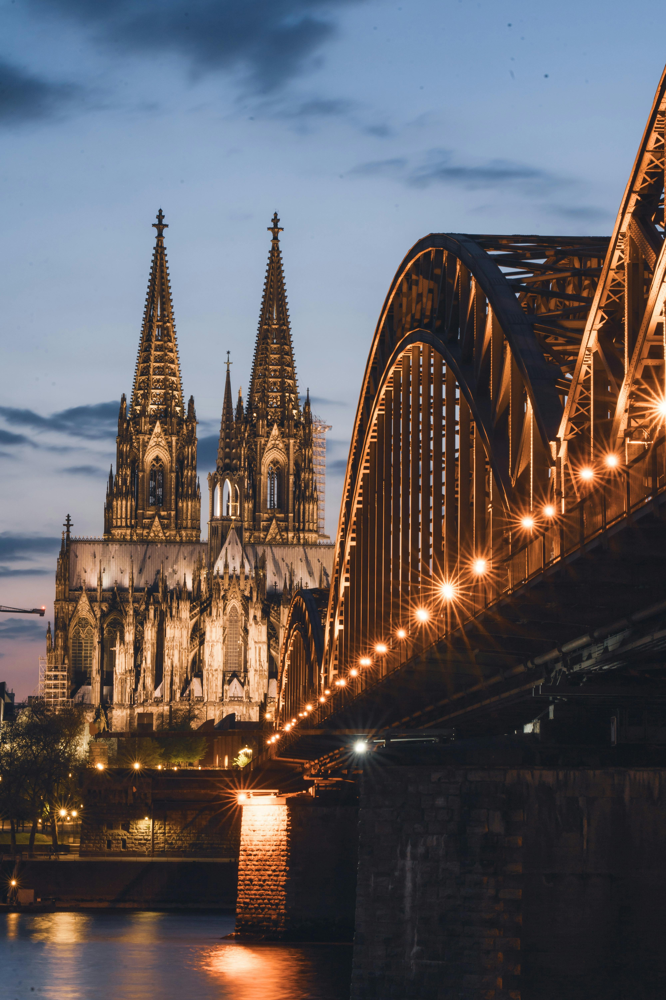

- neuschwanstein.jpg


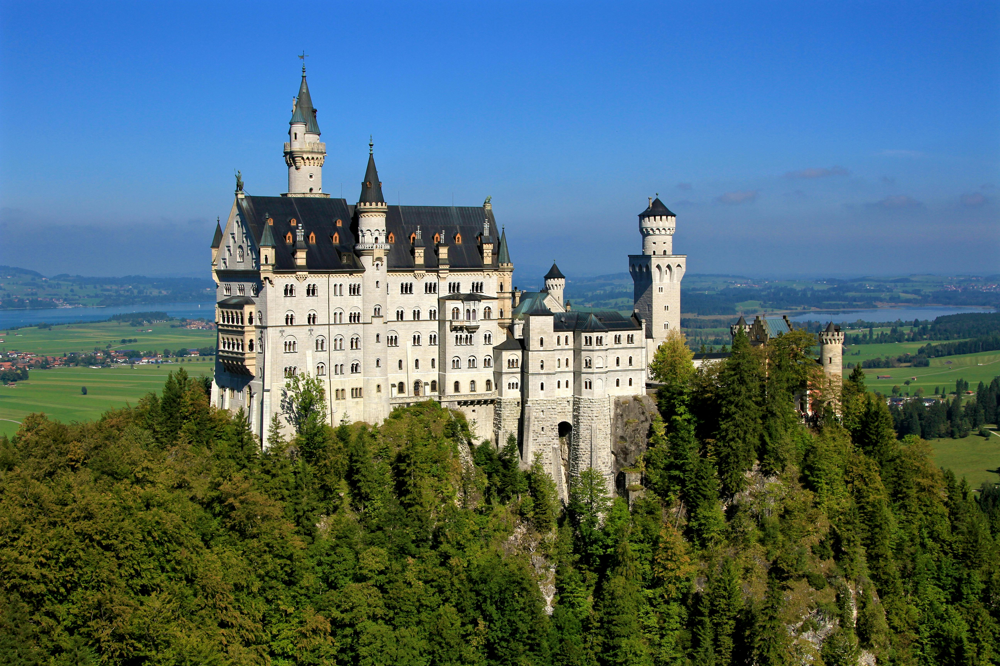

- brandenburgertor.jpg


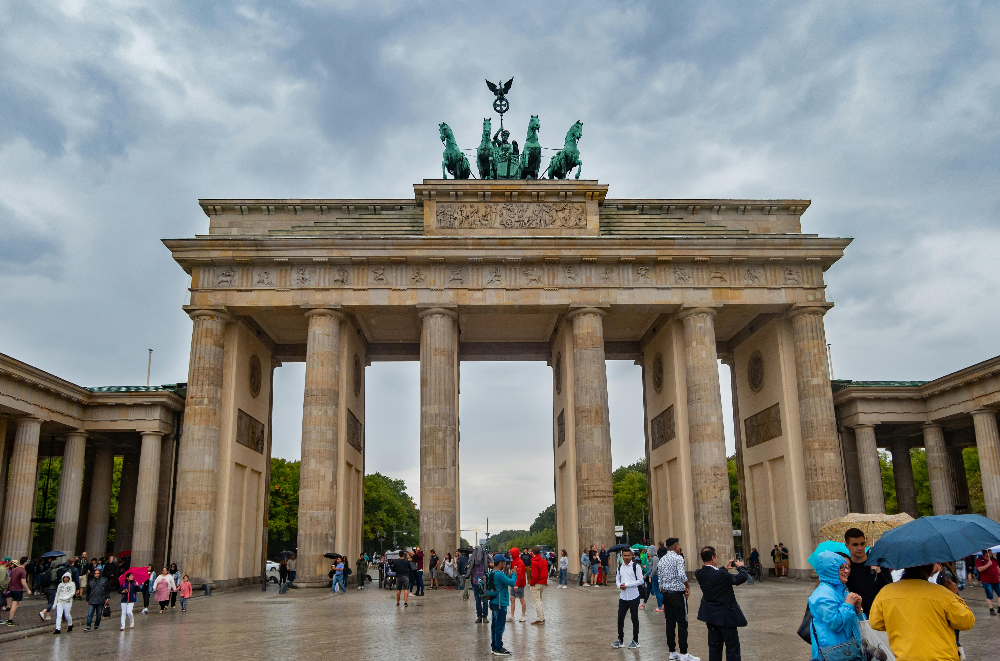


Sample Videos:
- istockphoto-2155845434-640_adpp_is.mp4
  Duration: 10.00 seconds, Frame Rate: 30.00 fps, Total Frames: 300
- istockphoto-2130816673-640_adpp_is.mp4
  Duration: 12.51 seconds, Frame Rate: 23.98 fps, Total Frames: 300
- istockphoto-1459776979-640_adpp_is.mp4
  Duration: 6.56 seconds, Frame Rate: 59.94 fps, Total Frames: 393
- istockphoto-1064039578-640_adpp_is.mp4
  Duration: 20.92 seconds, Frame Rate: 29.97 fps, Total Frames: 627
- istockphoto-2194461842-640_adpp_is.mp4
  Duration: 27.29 seconds, Frame Rate: 24.00 fps, Total Frames: 655


In [5]:
# TODO: Display sample images and video information
# Show image dimensions, video duration, frame rate, etc.

# YOUR CODE HERE

from IPython.display import Image, display#, Video
import os
import cv2

image_dir = 'german_tourism_data/images'
video_dir = 'german_tourism_data/videos'

# Display sample images
print("Sample Images:")
for filename in os.listdir(image_dir):
    if filename.endswith(('.jpg', '.jpeg', '.png')):
        print(f"- {filename}")
        display(Image(filename=os.path.join(image_dir, filename)))

print("\nSample Videos:")
for filename in os.listdir(video_dir):
    if filename.endswith(('.mp4', '.avi', '.mov')):
        video_path = os.path.join(video_dir, filename)
        print(f"- {filename}")

        # Get video information
        cap = cv2.VideoCapture(video_path)
        if cap.isOpened():
            frame_count = int(cap.get(cv2.CAP_PROP_FRAME_COUNT))
            fps = cap.get(cv2.CAP_PROP_FPS)
            duration = frame_count / fps if fps > 0 else 0
            print(f"  Duration: {duration:.2f} seconds, Frame Rate: {fps:.2f} fps, Total Frames: {frame_count}")
            cap.release()
        else:
            print("  Could not open video file to get information.")

        # Display the video
        # display(Video(filename=video_path, embed=True))

In [6]:
from IPython.display import Video, Image

def read_video_frames(video_path, num_samples=50):
  # Open the video file
    cap = cv2.VideoCapture(video_path)
    frames = []

    if not cap.isOpened():
        print("Error opening video file")
        return

    # Calculate total number of frames in the video
    total_frames = int(cap.get(cv2.CAP_PROP_FRAME_COUNT))

    # Determine the interval for sampling frames
    if total_frames > num_samples:
        frame_interval = total_frames // num_samples
    else:
        frame_interval = 1  # Take every frame if less than 50 frames are available

    # Capture frames at the determined interval
    for i in range(min(num_samples, total_frames)):
      frame_id = i * frame_interval
      cap.set(cv2.CAP_PROP_POS_FRAMES, frame_id)
      ret, frame = cap.read()
      if not ret:
          print("Failed to read frame or end of video reached")
          break
      # Resize frame for display purposes
      small_frame = cv2.resize(frame, (640, 480))  # Adjust the size as needed
      frames.append(small_frame)
    # Release the video capture object
    cap.release()
    return frames

## Modeling

In this section, we'll implement YOLO for detecting tourists and objects at German landmarks.

### YOLO Ultralytics Loading

We will utilize a pretrained YOLO model to create a tourism monitoring system for German landmarks with minimal effort. This system will be capable of detecting tourists, vehicles, luggage, and other objects relevant to tourism management.

`ultralytics/yolov5` is a popular and efficient implementation of the YOLO (You Only Look Once) object detection algorithm developed by Ultralytics. YOLOv5 is designed to offer high performance in terms of speed and accuracy for real-time object detection tasks.

### Key Features of YOLOv5:
1. **Pre-trained Models**: It includes multiple pre-trained models that can be used out-of-the-box for a variety of object detection tasks.
2. **Modularity and Scalability**: Offers a range of models with different sizes and complexities:
   - `yolov5n`: Nano version (smallest, fastest, but less accurate)
   - **`yolov5s`: Small version (fast and accurate)** We use this one below
   - `yolov5m`: Medium version (balanced speed and accuracy)
   - `yolov5l`: Large version (higher accuracy)
   - `yolov5x`: Extra-large version (most accurate, but slower)

3. **Ease of Use**: Includes easy-to-use functions for training, inference, and model evaluation, making it beginner-friendly.

### Architecture Overview:
- **Single-Stage Detection**: YOLOv5 is a single-stage object detector that directly predicts bounding boxes and class probabilities from the entire image in a single pass through the network.
- **Backbone and Neck**:
  - **Backbone**: Extracts feature maps from input images using convolutional layers.
  - **Neck**: Aggregates and refines these feature maps for better detection.
- **Head**: Predicts object classes and bounding boxes at multiple scales.

### Practical Applications for German Tourism:
1. **Real-time Tourist Monitoring**: For applications like crowd control, safety monitoring, and visitor flow analysis.
2. **Heritage Site Protection**: Detecting unauthorized activities near historical monuments.
3. **Tourism Analytics**: Understanding visitor patterns and popular areas within tourist sites.
4. **Emergency Response**: Quick identification of incidents or emergencies in crowded tourist areas.

In [9]:
# Load the YOLO model, here we use YOLOv5s as an example
model = torch.hub.load('ultralytics/yolov5', 'yolov5s', pretrained=True)

/usr/local/lib/python3.12/dist-packages/torch/hub.py:330: UserWarning: You are about to download and run code from an untrusted repository. In a future release, this won't be allowed. To add the repository to your trusted list, change the command to {calling_fn}(..., trust_repo=False) and a command prompt will appear asking for an explicit confirmation of trust, or load(..., trust_repo=True), which will assume that the prompt is to be answered with 'yes'. You can also use load(..., trust_repo='check') which will only prompt for confirmation if the repo is not already trusted. This will eventually be the default behaviour
  warnings.warn(


Downloading: "https://github.com/ultralytics/yolov5/zipball/master" to /root/.cache/torch/hub/master.zip
Creating new Ultralytics Settings v0.0.6 file ✅ 
View Ultralytics Settings with 'yolo settings' or at '/root/.config/Ultralytics/settings.json'
Update Settings with 'yolo settings key=value', i.e. 'yolo settings runs_dir=path/to/dir'. For help see https://docs.ultralytics.com/quickstart/#ultralytics-settings.


YOLOv5 🚀 2025-10-1 Python-3.12.11 torch-2.8.0+cu126 CUDA:0 (NVIDIA L4, 22693MiB)

100%|██████████| 14.1M/14.1M [00:00<00:00, 183MB/s]

Fusing layers... 
YOLOv5s summary: 213 layers, 7225885 parameters, 0 gradients, 16.4 GFLOPs
Adding AutoShape... 


**The detect_and_draw function**

It identifies objects in a video frame using a pre-trained YOLO model. It converts the frame from BGR (OpenCV format) to RGB (model format), detects objects, draws bounding boxes and labels on the frame, and then converts it back to BGR for display.

Here's the Code Breakdown:

1. **Convert Color Format:** It converts the frame from BGR (used by OpenCV) to RGB because the detection model requires this format.
2. **Object Detection:** The frame is analyzed by the model, which detects objects and marks them with bounding boxes.
3. **Render Annotations:** The detected bounding boxes and labels are drawn directly onto the frame.
4. **Convert Back:** Converts the RGB image back to BGR so that it can be displayed or processed further using OpenCV tools.

This function enables real-time object detection in video streams, making it ideal for applications such as surveillance, traffic monitoring, and interactive systems.

In [10]:
def detect_and_draw(model, frame):
    # Convert BGR frame to RGB
    frame_rgb = cv2.cvtColor(frame, cv2.COLOR_BGR2RGB)

    # Perform inference
    results = model(frame_rgb)

    # # Render results (bounding boxes and labels) back onto the frame
    results.render()

    # Convert RGB back to BGR for OpenCV compatibility
    output_frame = cv2.cvtColor(frame_rgb, cv2.COLOR_RGB2BGR)
    return output_frame


In [11]:
# TODO: Also create a function to count specific objects
def count_tourism_objects(results):
    """
    Count tourists, vehicles, and other objects detected

    """
    # YOUR CODE HERE
    pass

### YOLO Image Testing on German Tourist Attractions

Let's test our YOLO model on static images from German landmarks before processing videos.

Testing YOLO on sample images:

Processing image: cologne_cathedral.jpg


/root/.cache/torch/hub/ultralytics_yolov5_master/models/common.py:906: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with amp.autocast(autocast):


Saved result to german_tourism_data/results/detected_cologne_cathedral.jpg


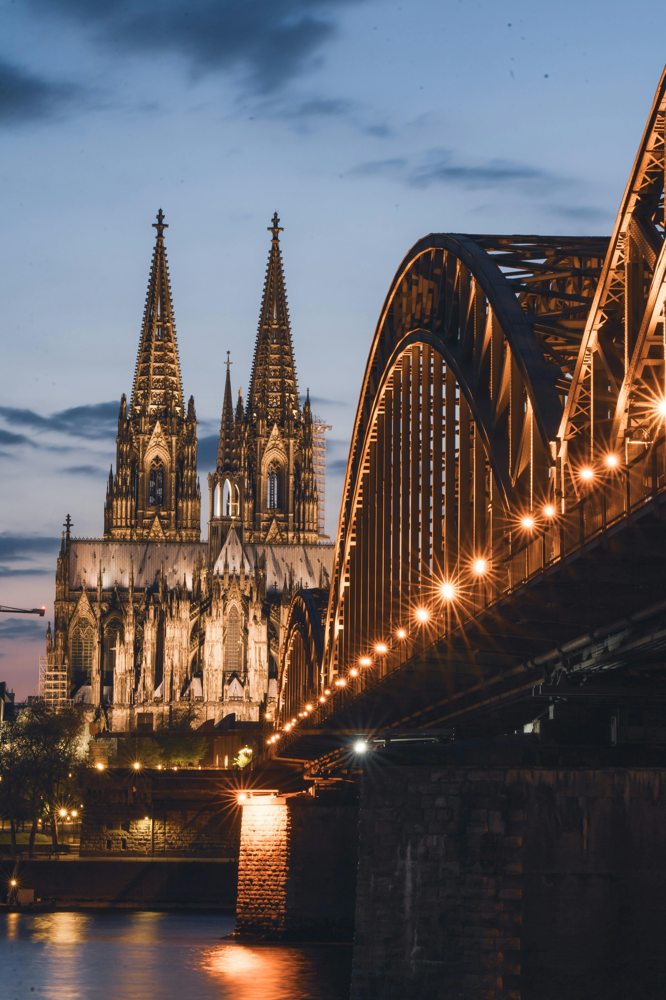


Processing image: neuschwanstein.jpg


/root/.cache/torch/hub/ultralytics_yolov5_master/models/common.py:906: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with amp.autocast(autocast):


Saved result to german_tourism_data/results/detected_neuschwanstein.jpg


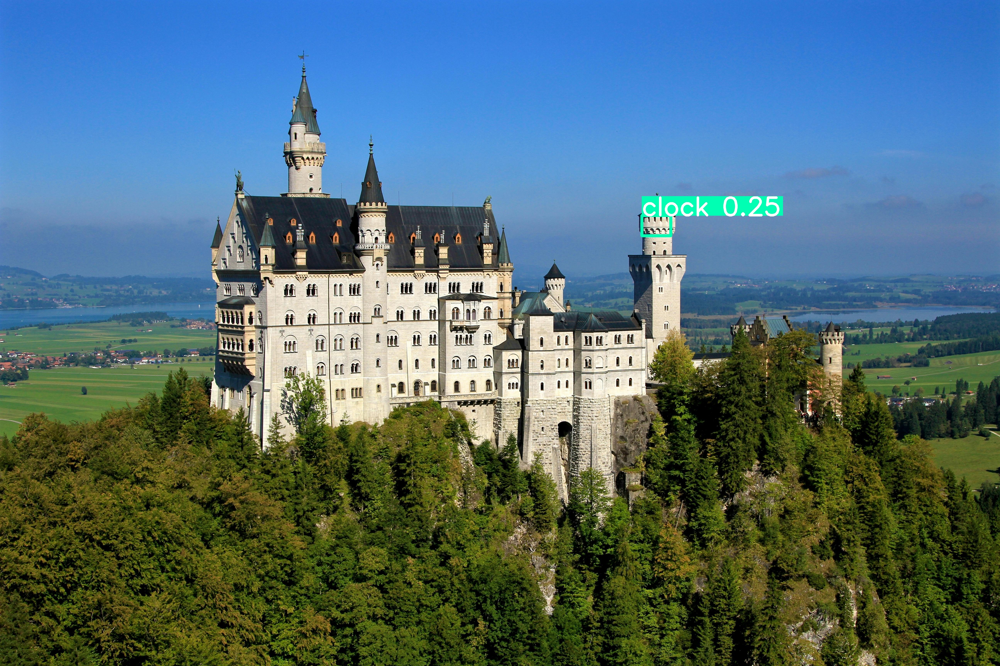


Processing image: brandenburgertor.jpg


/root/.cache/torch/hub/ultralytics_yolov5_master/models/common.py:906: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with amp.autocast(autocast):


Saved result to german_tourism_data/results/detected_brandenburgertor.jpg


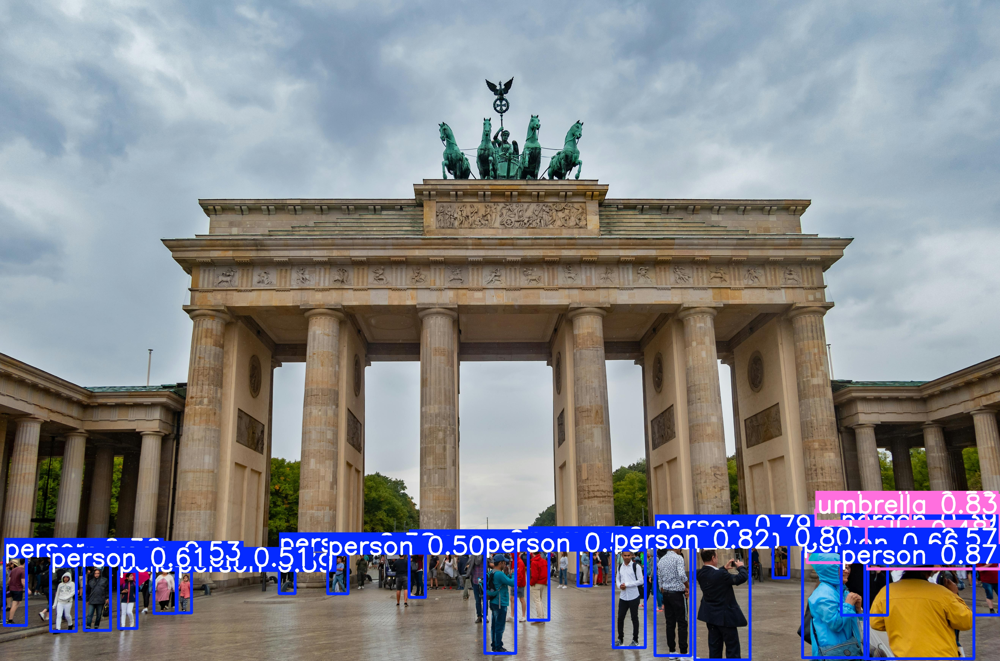

In [12]:
# TODO: Test YOLO on sample images of German tourist attractions

# YOUR CODE HERE

from IPython.display import Image, display
import os

image_dir = 'german_tourism_data/images'

print("Testing YOLO on sample images:")

for filename in os.listdir(image_dir):
    if filename.endswith(('.jpg', '.jpeg', '.png')):
        image_path = os.path.join(image_dir, filename)
        print(f"\nProcessing image: {filename}")

        # Read the image
        img = cv2.imread(image_path)

        if img is not None:
            # Perform object detection and draw results
            output_img = detect_and_draw(model, img)

            # Save the result (optional)
            output_path = os.path.join('german_tourism_data/results', f'detected_{filename}')
            cv2.imwrite(output_path, output_img)
            print(f"Saved result to {output_path}")

            # Display the result
            display(Image(filename=output_path))
        else:
            print(f"Could not read image: {filename}")

### Video Processing for German Tourism Monitoring

Now let's define a comprehensive function to handle video processing for tourism monitoring. This function will read tourism videos from German landmarks, process each frame to detect tourists and objects, and write the results to new annotated video files.

In [ ]:
# TODO: Create a comprehensive video processing function for tourism monitoring

#def process_tourism_video(input_path, output_path, model):

    # YOUR CODE HERE

#    pass

# TODO: Create a function for real-time tourism analytics

#def analyze_tourism_patterns(results_list):

    # YOUR CODE HERE


  #  pass

In [47]:
def process_tourism_video(input_path, output_path, model):
    """
    Processes a tourism video by performing object detection on each frame
    and saving the annotated frames to a new video file.

    Args:
        input_path (str): The path to the input video file.
        output_path (str): The path to save the output annotated video file.
        model: The loaded YOLO object detection model.

    Returns:
        list: A list of YOLOv5 detection results for each frame, or None if processing fails.
    """
    # Initialize video capture
    cap = cv2.VideoCapture(input_path)

    # Check if video opened successfully
    if not cap.isOpened():
        print(f"Error opening video file: {input_path}")
        return None

    # Get video properties
    frame_width = int(cap.get(cv2.CAP_PROP_FRAME_WIDTH))
    frame_height = int(cap.get(cv2.CAP_PROP_FRAME_HEIGHT))
    fps = int(cap.get(cv2.CAP_PROP_FPS))

    # Initialize video writer
    # Define the codec and create VideoWriter object
    fourcc = cv2.VideoWriter_fourcc(*'mp4v') # You can use other codecs like 'XVID'
    out = cv2.VideoWriter(output_path, fourcc, fps, (frame_width, frame_height))

    # Check if video writer was initialized successfully
    if not out.isOpened():
        print(f"Error initializing video writer: {output_path}")
        cap.release()
        return None

    print(f"Processing video: {input_path}")

    detection_results_list = []
    # Process frames
    while cap.isOpened():
        ret, frame = cap.read()
        if not ret:
            break # End of video or error

        # Perform object detection
        results = model(frame)
        detection_results_list.append(results)

        # Render results (bounding boxes and labels) back onto the frame
        results.render()
        output_frame = results.ims[0] # Get the annotated frame as a numpy array

        # Write the annotated frame to the output video
        out.write(output_frame)

    # Release video capture and writer objects
    cap.release()
    out.release()
    print(f"Finished processing video: {input_path}. Output saved to {output_path}")

    return detection_results_list

In [53]:
def analyze_tourism_patterns(results_list):
    """
    Analyze tourism detection results to gain insights into patterns.

    Args:
        results_list (list): A list containing the results of object detection
                             for each frame of the processed videos.
    """
    # TODO: Implement comprehensive analysis of tourism detection results
    # Generate charts and statistics about tourist patterns
    pass

### Execute Video Processing

Let's process our German tourism videos with YOLO object detection.

In [49]:
# TODO: Process each tourism video
# Apply object detection and save annotated results

import os

video_dir = 'german_tourism_data/videos'
results_dir = 'german_tourism_data/results'
all_videos_detection_results = {}

print("Processing videos:")

for filename in os.listdir(video_dir):
    if filename.endswith(('.mp4', '.avi', '.mov')):
        input_path = os.path.join(video_dir, filename)
        output_path = os.path.join(results_dir, f'detected_{filename}')

        # Process the video and get detection results
        detection_results = process_tourism_video(input_path, output_path, model)

        # Store results for this video
        all_videos_detection_results[filename] = detection_results

print("\nFinished processing all videos and gathered detection results.")

Processing videos:
Processing video: german_tourism_data/videos/istockphoto-2155845434-640_adpp_is.mp4


/root/.cache/torch/hub/ultralytics_yolov5_master/models/common.py:906: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with amp.autocast(autocast):
/root/.cache/torch/hub/ultralytics_yolov5_master/models/common.py:906: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with amp.autocast(autocast):
/root/.cache/torch/hub/ultralytics_yolov5_master/models/common.py:906: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with amp.autocast(autocast):
/root/.cache/torch/hub/ultralytics_yolov5_master/models/common.py:906: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with amp.autocast(autocast):
/root/.cache/torch/hub/ultralytics_yolov5_master/models/common.py:906: FutureWarning: `torch.cuda.am

Finished processing video: german_tourism_data/videos/istockphoto-2155845434-640_adpp_is.mp4. Output saved to german_tourism_data/results/detected_istockphoto-2155845434-640_adpp_is.mp4
Processing video: german_tourism_data/videos/istockphoto-2130816673-640_adpp_is.mp4


/root/.cache/torch/hub/ultralytics_yolov5_master/models/common.py:906: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with amp.autocast(autocast):
/root/.cache/torch/hub/ultralytics_yolov5_master/models/common.py:906: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with amp.autocast(autocast):
/root/.cache/torch/hub/ultralytics_yolov5_master/models/common.py:906: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with amp.autocast(autocast):
/root/.cache/torch/hub/ultralytics_yolov5_master/models/common.py:906: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with amp.autocast(autocast):
/root/.cache/torch/hub/ultralytics_yolov5_master/models/common.py:906: FutureWarning: `torch.cuda.am

Finished processing video: german_tourism_data/videos/istockphoto-2130816673-640_adpp_is.mp4. Output saved to german_tourism_data/results/detected_istockphoto-2130816673-640_adpp_is.mp4
Processing video: german_tourism_data/videos/istockphoto-1459776979-640_adpp_is.mp4


/root/.cache/torch/hub/ultralytics_yolov5_master/models/common.py:906: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with amp.autocast(autocast):
/root/.cache/torch/hub/ultralytics_yolov5_master/models/common.py:906: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with amp.autocast(autocast):
/root/.cache/torch/hub/ultralytics_yolov5_master/models/common.py:906: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with amp.autocast(autocast):
/root/.cache/torch/hub/ultralytics_yolov5_master/models/common.py:906: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with amp.autocast(autocast):
/root/.cache/torch/hub/ultralytics_yolov5_master/models/common.py:906: FutureWarning: `torch.cuda.am

Finished processing video: german_tourism_data/videos/istockphoto-1459776979-640_adpp_is.mp4. Output saved to german_tourism_data/results/detected_istockphoto-1459776979-640_adpp_is.mp4
Processing video: german_tourism_data/videos/istockphoto-1064039578-640_adpp_is.mp4


/root/.cache/torch/hub/ultralytics_yolov5_master/models/common.py:906: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with amp.autocast(autocast):
/root/.cache/torch/hub/ultralytics_yolov5_master/models/common.py:906: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with amp.autocast(autocast):
/root/.cache/torch/hub/ultralytics_yolov5_master/models/common.py:906: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with amp.autocast(autocast):
/root/.cache/torch/hub/ultralytics_yolov5_master/models/common.py:906: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with amp.autocast(autocast):
/root/.cache/torch/hub/ultralytics_yolov5_master/models/common.py:906: FutureWarning: `torch.cuda.am

Finished processing video: german_tourism_data/videos/istockphoto-1064039578-640_adpp_is.mp4. Output saved to german_tourism_data/results/detected_istockphoto-1064039578-640_adpp_is.mp4
Processing video: german_tourism_data/videos/istockphoto-2194461842-640_adpp_is.mp4


/root/.cache/torch/hub/ultralytics_yolov5_master/models/common.py:906: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with amp.autocast(autocast):
/root/.cache/torch/hub/ultralytics_yolov5_master/models/common.py:906: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with amp.autocast(autocast):
/root/.cache/torch/hub/ultralytics_yolov5_master/models/common.py:906: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with amp.autocast(autocast):
/root/.cache/torch/hub/ultralytics_yolov5_master/models/common.py:906: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with amp.autocast(autocast):
/root/.cache/torch/hub/ultralytics_yolov5_master/models/common.py:906: FutureWarning: `torch.cuda.am

Finished processing video: german_tourism_data/videos/istockphoto-2194461842-640_adpp_is.mp4. Output saved to german_tourism_data/results/detected_istockphoto-2194461842-640_adpp_is.mp4

Finished processing all videos and gathered detection results.


/root/.cache/torch/hub/ultralytics_yolov5_master/models/common.py:906: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with amp.autocast(autocast):
/root/.cache/torch/hub/ultralytics_yolov5_master/models/common.py:906: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with amp.autocast(autocast):
/root/.cache/torch/hub/ultralytics_yolov5_master/models/common.py:906: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with amp.autocast(autocast):
/root/.cache/torch/hub/ultralytics_yolov5_master/models/common.py:906: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with amp.autocast(autocast):
/root/.cache/torch/hub/ultralytics_yolov5_master/models/common.py:906: FutureWarning: `torch.cuda.am

## Results Analysis and Tourism Insights

Let's analyze our detection results to gain insights into German tourism patterns.

In [50]:
# TODO: Create comprehensive analysis of tourism detection results
# Generate charts and statistics about tourist patterns

# YOUR CODE HERE

# Example: Count objects of specific classes (e.g., 'person', 'car')
object_counts = {}
crowd_density_results = {}
heatmaps = {}

for video_filename, results_list in all_videos_detection_results.items():
    print(f"\nAnalyzing results for {video_filename}:")
    video_object_counts = {}
    video_density_scores = []

    # Assuming you have the frame width and height available
    # You might need to get this information from the video file properties
    # For demonstration, let's assume a fixed size or retrieve it from the first frame
    frame_width, frame_height = 640, 480 # Replace with actual video dimensions if available

    for frame_results in results_list:
        # Assuming frame_results is a YOLOv5 results object
        # You might need to adapt this based on the actual structure of your results
        if frame_results and frame_results.pred is not None:
            for *box, conf, cls in frame_results.pred[0]:
                class_name = model.names[int(cls)]
                if class_name not in video_object_counts:
                    video_object_counts[class_name] = 0
                video_object_counts[class_name] += 1

            # Estimate crowd density for the frame
            density = estimate_crowd_density(frame_results, frame_width, frame_height)
            video_density_scores.append(density)


    object_counts[video_filename] = video_object_counts
    crowd_density_results[video_filename] = video_density_scores
    print(f"Object counts for {video_filename}: {video_object_counts}")

    # Create and store heatmap for the video
    if results_list: # Ensure there are results before creating heatmap
        heatmap = create_tourism_heatmap(results_list, frame_width, frame_height)
        heatmaps[video_filename] = heatmap
        print(f"Generated heatmap for {video_filename}")


Analyzing results for istockphoto-2155845434-640_adpp_is.mp4:
Object counts for istockphoto-2155845434-640_adpp_is.mp4: {'person': 4512, 'clock': 299, 'suitcase': 100, 'bicycle': 189, 'bus': 31, 'train': 40, 'backpack': 106, 'dog': 3, 'handbag': 412, 'bench': 2, 'umbrella': 8, 'horse': 11, 'car': 5, 'tie': 2, 'cell phone': 1, 'fire hydrant': 1, 'truck': 1, 'traffic light': 3, 'motorcycle': 1, 'elephant': 1}
Generated heatmap for istockphoto-2155845434-640_adpp_is.mp4

Analyzing results for istockphoto-2130816673-640_adpp_is.mp4:
Object counts for istockphoto-2130816673-640_adpp_is.mp4: {'person': 307, 'clock': 98, 'backpack': 148, 'cell phone': 296, 'handbag': 201}
Generated heatmap for istockphoto-2130816673-640_adpp_is.mp4

Analyzing results for istockphoto-1459776979-640_adpp_is.mp4:
Object counts for istockphoto-1459776979-640_adpp_is.mp4: {'bus': 242, 'person': 2778, 'car': 345, 'bicycle': 100, 'handbag': 48, 'traffic light': 826, 'tie': 35, 'umbrella': 1, 'tv': 18, 'motorcycle':

## Advanced Features for Tourism Management

Let's implement some advanced features for better tourism management.

### Crowd Density Analysis

Implement crowd density analysis to help manage tourist flow at German landmarks.

In [51]:
# TODO: Implement crowd density analysis
# Create functions to analyze crowd density and generate warnings
# You can now use the object_counts, crowd_density_results, and heatmaps dictionaries for further analysis and visualization

# Example: Print average crowd density for each video
print("\nAverage Crowd Density:")
for video_filename, density_scores in crowd_density_results.items():
    if density_scores:
        average_density = sum(density_scores) / len(density_scores)
        print(f"{video_filename}: {average_density:.2f}")
    else:
        print(f"{video_filename}: No density data available")


Average Crowd Density:
istockphoto-2155845434-640_adpp_is.mp4: 0.49
istockphoto-2130816673-640_adpp_is.mp4: 0.03
istockphoto-1459776979-640_adpp_is.mp4: 0.23
istockphoto-1064039578-640_adpp_is.mp4: 0.00
istockphoto-2194461842-640_adpp_is.mp4: 0.00


### Tourism Activity Heatmap

Create heatmaps showing where tourists spend most of their time at German landmarks.

In [56]:
# TODO: Create tourism activity heatmaps
# Show where tourists are most active in the video frames

# YOUR CODE HERE

import numpy as np
import matplotlib.pyplot as plt

def create_tourism_heatmap(video_results, frame_width, frame_height, grid_size=(20, 20)):
    """
    Creates a heatmap showing the density of detected objects (e.g., people)
    across the video frames.

    Args:
        video_results (list): A list of YOLOv5 detection results for each frame
                              of a single video.
        frame_width (int): The width of the video frames.
        frame_height (int): The height of the video frames.
        grid_size (tuple): The number of cells in the heatmap grid (rows, columns).

    Returns:
        np.ndarray: A 2D numpy array representing the heatmap.
    """
    # Initialize heatmap grid
    heatmap = np.zeros(grid_size)
    grid_height, grid_width = grid_size
    cell_width = frame_width / grid_width
    cell_height = frame_height / grid_height

    # Populate heatmap based on object locations
    for frame_results in video_results:
        if frame_results and frame_results.pred is not None:
            for *box, conf, cls in frame_results.pred[0]:
                class_name = model.names[int(cls)]
                # Consider only 'person' detections for tourism activity heatmap
                if class_name == 'person':
                    x_center = (box[0] + box[2]) / 2  # Center x-coordinate of bounding box
                    y_center = (box[1] + box[3]) / 2  # Center y-coordinate of bounding box

                    # Determine which grid cell the object center falls into
                    grid_x = min(int(x_center / cell_width), grid_width - 1)
                    grid_y = min(int(y_center / cell_height), grid_height - 1)

                    # Increment the count for that grid cell
                    heatmap[grid_y, grid_x] += 1

    return heatmap

# Display heatmaps
print("\nTourism Activity Heatmaps:")
for video_filename, heatmap in heatmaps.items():
    plt.figure(figsize=(10, 8))
    plt.imshow(heatmap, cmap='hot', interpolation='nearest')
    plt.title(f'Tourism Activity Heatmap for {video_filename}')
    plt.colorbar(label='Activity Count')
    plt.xlabel('Horizontal Position')
    plt.ylabel('Vertical Position')
    plt.show()

plt.close('all') # Close all figure windows after displaying


Tourism Activity Heatmaps:


## Submission Guidelines

### Required Deliverables:
1. **Completed Jupyter Notebook** with all code cells filled in
2. **Processed Videos** showing object detection results


### Bonus Points:
- Implementation of advanced features beyond basic requirements
- Creative solutions for tourism-specific challenges
- Integration of additional data sources or analysis methods
- Exceptional documentation and code organization